In [1]:
import cv2
import numpy as np
import threading

def compute_mhi(video_path, start_frame, end_frame, initial_threshold=64):
    cap = cv2.VideoCapture(video_path)
    fps = cap.get(cv2.CAP_PROP_FPS)
    frame_duration = int(fps * 2.0)  # 2 saniyelik frame'ler alınacak
    timestamp = start_frame
    
    cap.set(cv2.CAP_PROP_POS_FRAMES, start_frame)  # Başlangıç karesine atla
    mhi = None
    
    while True:
        frames = []
        for _ in range(frame_duration):
            ret, frame = cap.read()
            if not ret:
                break
            frames.append(cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY))
        
        if not frames:
            break
        
        for i, frame in enumerate(frames):
            if i == 0:
                prev_frame = frame
                continue
            current_frame = frame
            frame_diff = cv2.absdiff(current_frame, prev_frame)
            _, motion_mask = cv2.threshold(frame_diff, initial_threshold, 1, cv2.THRESH_BINARY)
            
            timestamp += 1 
            
            if mhi is None:
                mhi = np.zeros_like(prev_frame, dtype=np.float32)
            mhi = np.maximum(mhi - 1/frame_duration, 0)
            mhi[motion_mask == 1] = timestamp
            prev_frame = current_frame  
        
        mhi_normalized = np.uint8(np.clip((mhi - (timestamp - frame_duration)) / frame_duration, 0, 1) * 255)
        
        mhi_filename = f'/home/muhlabws4/dosyalar/diger/3_may_resim4/mhi_{timestamp-int(fps*2)+1}_to_{timestamp}.png'
        cv2.imwrite(mhi_filename, mhi_normalized)
        print(f"MHI saved: {mhi_filename}")
        
        if timestamp >= end_frame:
            break
    
    cap.release()

video_path = '/home/muhlabws4/Videolar/video4.mp4'   
initial_threshold = 32


# Video dosyasını açın
video = cv2.VideoCapture(video_path)

# FPS (kare hızı) bilgisini alın
fps = video.get(cv2.CAP_PROP_FPS)

# Toplam kare sayısını alın
frame_count = int(video.get(cv2.CAP_PROP_FRAME_COUNT))

# İlk iş parçacığı için
thread1 = threading.Thread(target=compute_mhi, args=(video_path, 0, frame_count, initial_threshold))

thread2 = threading.Thread(target=compute_mhi, args=(video_path, 10, frame_count, initial_threshold))
thread3 = threading.Thread(target=compute_mhi, args=(video_path, 20, frame_count, initial_threshold))

thread4 = threading.Thread(target=compute_mhi, args=(video_path, 30, frame_count, initial_threshold))

thread5 = threading.Thread(target=compute_mhi, args=(video_path, 5, frame_count, initial_threshold))

thread6 = threading.Thread(target=compute_mhi, args=(video_path, 15, frame_count, initial_threshold))
thread7 = threading.Thread(target=compute_mhi, args=(video_path, 25, frame_count, initial_threshold))



# İş parçacıklarını başlat
thread1.start()
thread2.start()
thread3.start()
thread4.start()
thread5.start()
thread6.start()
thread7.start()
# İş parçacıklarının tamamlanmasını bekle
thread1.join()
thread2.join()
thread3.join()
thread4.join()
thread5.join()
thread6.join()
thread7.join()

print("Tüm işlemler tamamlandı.")

MHI saved: /home/muhlabws4/dosyalar/diger/3_may_resim4/mhi_0_to_49.png
MHI saved: /home/muhlabws4/dosyalar/diger/3_may_resim4/mhi_10_to_59.png
MHI saved: /home/muhlabws4/dosyalar/diger/3_may_resim4/mhi_15_to_64.png
MHI saved: /home/muhlabws4/dosyalar/diger/3_may_resim4/mhi_30_to_79.png
MHI saved: /home/muhlabws4/dosyalar/diger/3_may_resim4/mhi_20_to_69.png
MHI saved: /home/muhlabws4/dosyalar/diger/3_may_resim4/mhi_5_to_54.png
MHI saved: /home/muhlabws4/dosyalar/diger/3_may_resim4/mhi_25_to_74.png
MHI saved: /home/muhlabws4/dosyalar/diger/3_may_resim4/mhi_49_to_98.png
MHI saved: /home/muhlabws4/dosyalar/diger/3_may_resim4/mhi_79_to_128.png
MHI saved: /home/muhlabws4/dosyalar/diger/3_may_resim4/mhi_59_to_108.png
MHI saved: /home/muhlabws4/dosyalar/diger/3_may_resim4/mhi_64_to_113.png
MHI saved: /home/muhlabws4/dosyalar/diger/3_may_resim4/mhi_54_to_103.png
MHI saved: /home/muhlabws4/dosyalar/diger/3_may_resim4/mhi_69_to_118.png
MHI saved: /home/muhlabws4/dosyalar/diger/3_may_resim4/mhi_74

MHI saved: /home/muhlabws4/dosyalar/diger/3_may_resim4/mhi_814_to_863.png
MHI saved: /home/muhlabws4/dosyalar/diger/3_may_resim4/mhi_784_to_833.png
MHI saved: /home/muhlabws4/dosyalar/diger/3_may_resim4/mhi_809_to_858.png
MHI saved: /home/muhlabws4/dosyalar/diger/3_may_resim4/mhi_799_to_848.png
MHI saved: /home/muhlabws4/dosyalar/diger/3_may_resim4/mhi_794_to_843.png
MHI saved: /home/muhlabws4/dosyalar/diger/3_may_resim4/mhi_789_to_838.png
MHI saved: /home/muhlabws4/dosyalar/diger/3_may_resim4/mhi_804_to_853.png
MHI saved: /home/muhlabws4/dosyalar/diger/3_may_resim4/mhi_863_to_912.png
MHI saved: /home/muhlabws4/dosyalar/diger/3_may_resim4/mhi_833_to_882.png
MHI saved: /home/muhlabws4/dosyalar/diger/3_may_resim4/mhi_858_to_907.png
MHI saved: /home/muhlabws4/dosyalar/diger/3_may_resim4/mhi_848_to_897.png
MHI saved: /home/muhlabws4/dosyalar/diger/3_may_resim4/mhi_838_to_887.png
MHI saved: /home/muhlabws4/dosyalar/diger/3_may_resim4/mhi_843_to_892.png
MHI saved: /home/muhlabws4/dosyalar/di

MHI saved: /home/muhlabws4/dosyalar/diger/3_may_resim4/mhi_1598_to_1647.png
MHI saved: /home/muhlabws4/dosyalar/diger/3_may_resim4/mhi_1534_to_1583.png
MHI saved: /home/muhlabws4/dosyalar/diger/3_may_resim4/mhi_1524_to_1573.png
MHI saved: /home/muhlabws4/dosyalar/diger/3_may_resim4/mhi_1539_to_1588.png
MHI saved: /home/muhlabws4/dosyalar/diger/3_may_resim4/mhi_1568_to_1617.png
MHI saved: /home/muhlabws4/dosyalar/diger/3_may_resim4/mhi_1593_to_1642.png
MHI saved: /home/muhlabws4/dosyalar/diger/3_may_resim4/mhi_1578_to_1627.png
MHI saved: /home/muhlabws4/dosyalar/diger/3_may_resim4/mhi_1647_to_1696.png
MHI saved: /home/muhlabws4/dosyalar/diger/3_may_resim4/mhi_1583_to_1632.png
MHI saved: /home/muhlabws4/dosyalar/diger/3_may_resim4/mhi_1573_to_1622.png
MHI saved: /home/muhlabws4/dosyalar/diger/3_may_resim4/mhi_1588_to_1637.png
MHI saved: /home/muhlabws4/dosyalar/diger/3_may_resim4/mhi_1617_to_1666.png
MHI saved: /home/muhlabws4/dosyalar/diger/3_may_resim4/mhi_1642_to_1691.png
MHI saved: /

MHI saved: /home/muhlabws4/dosyalar/diger/3_may_resim4/mhi_2259_to_2308.png
MHI saved: /home/muhlabws4/dosyalar/diger/3_may_resim4/mhi_2328_to_2377.png
MHI saved: /home/muhlabws4/dosyalar/diger/3_may_resim4/mhi_2274_to_2323.png
MHI saved: /home/muhlabws4/dosyalar/diger/3_may_resim4/mhi_2313_to_2362.png
MHI saved: /home/muhlabws4/dosyalar/diger/3_may_resim4/mhi_2382_to_2431.png
MHI saved: /home/muhlabws4/dosyalar/diger/3_may_resim4/mhi_2318_to_2367.png
MHI saved: /home/muhlabws4/dosyalar/diger/3_may_resim4/mhi_2352_to_2401.png
MHI saved: /home/muhlabws4/dosyalar/diger/3_may_resim4/mhi_2308_to_2357.png
MHI saved: /home/muhlabws4/dosyalar/diger/3_may_resim4/mhi_2377_to_2426.png
MHI saved: /home/muhlabws4/dosyalar/diger/3_may_resim4/mhi_2323_to_2372.png
MHI saved: /home/muhlabws4/dosyalar/diger/3_may_resim4/mhi_2362_to_2411.png
MHI saved: /home/muhlabws4/dosyalar/diger/3_may_resim4/mhi_2431_to_2480.png
MHI saved: /home/muhlabws4/dosyalar/diger/3_may_resim4/mhi_2367_to_2416.png
MHI saved: /

In [3]:
import cv2
import os

# Videonun dosya yolu
video_path = '/home/muhlabws4/Videolar/video4.mp4'

# Kaydedilecek klasörün dosya yolu
output_folder = '/home/muhlabws4/dosyalar/diger/3_may_frame4'

# Eğer kaydedilecek klasör yoksa oluştur
os.makedirs(output_folder, exist_ok=True)

# Videoyu aç
cap = cv2.VideoCapture(video_path)

# Video boyutunu al
frame_count = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))

# Frame'lerin alınacağı sıklık
frame_interval = 5

# Frame sayacı
frame_number = 0

# Frame okuma döngüsü
while True:
    # Bir sonraki frame'i al
    ret, frame = cap.read()
    
    # Videodan frame alınmadıysa döngüyü sonlandır
    if not ret:
        break
    
    # Frame sayacını artır
    frame_number += 1
    
    # Frame sayısına göre kaydetme işlemi
    if frame_number % frame_interval == 0:
        # Frame'i kaydetmek için dosya yolu
        save_path = os.path.join(output_folder, f'frame_{frame_number}.jpg')
        
        # Frame'i kaydet
        cv2.imwrite(save_path, frame)
        
        print(f"Frame {frame_number} kaydedildi.")
    
    # Videoyu göstermek için eğer istenirse
    # cv2.imshow('Frame', frame)
    # if cv2.waitKey(1) & 0xFF == ord('q'):
    #     break

# Videoyu serbest bırak
cap.release()

# cv2.destroyAllWindows()  # Eğer gösterme işlemi yapılıyorsa


Frame 5 kaydedildi.
Frame 10 kaydedildi.
Frame 15 kaydedildi.
Frame 20 kaydedildi.
Frame 25 kaydedildi.
Frame 30 kaydedildi.
Frame 35 kaydedildi.
Frame 40 kaydedildi.
Frame 45 kaydedildi.
Frame 50 kaydedildi.
Frame 55 kaydedildi.
Frame 60 kaydedildi.
Frame 65 kaydedildi.
Frame 70 kaydedildi.
Frame 75 kaydedildi.
Frame 80 kaydedildi.
Frame 85 kaydedildi.
Frame 90 kaydedildi.
Frame 95 kaydedildi.
Frame 100 kaydedildi.
Frame 105 kaydedildi.
Frame 110 kaydedildi.
Frame 115 kaydedildi.
Frame 120 kaydedildi.
Frame 125 kaydedildi.
Frame 130 kaydedildi.
Frame 135 kaydedildi.
Frame 140 kaydedildi.
Frame 145 kaydedildi.
Frame 150 kaydedildi.
Frame 155 kaydedildi.
Frame 160 kaydedildi.
Frame 165 kaydedildi.
Frame 170 kaydedildi.
Frame 175 kaydedildi.
Frame 180 kaydedildi.
Frame 185 kaydedildi.
Frame 190 kaydedildi.
Frame 195 kaydedildi.
Frame 200 kaydedildi.
Frame 205 kaydedildi.
Frame 210 kaydedildi.
Frame 215 kaydedildi.
Frame 220 kaydedildi.
Frame 225 kaydedildi.
Frame 230 kaydedildi.
Frame 23

Frame 1835 kaydedildi.
Frame 1840 kaydedildi.
Frame 1845 kaydedildi.
Frame 1850 kaydedildi.
Frame 1855 kaydedildi.
Frame 1860 kaydedildi.
Frame 1865 kaydedildi.
Frame 1870 kaydedildi.
Frame 1875 kaydedildi.
Frame 1880 kaydedildi.
Frame 1885 kaydedildi.
Frame 1890 kaydedildi.
Frame 1895 kaydedildi.
Frame 1900 kaydedildi.
Frame 1905 kaydedildi.
Frame 1910 kaydedildi.
Frame 1915 kaydedildi.
Frame 1920 kaydedildi.
Frame 1925 kaydedildi.
Frame 1930 kaydedildi.
Frame 1935 kaydedildi.
Frame 1940 kaydedildi.
Frame 1945 kaydedildi.
Frame 1950 kaydedildi.
Frame 1955 kaydedildi.
Frame 1960 kaydedildi.
Frame 1965 kaydedildi.
Frame 1970 kaydedildi.
Frame 1975 kaydedildi.
Frame 1980 kaydedildi.
Frame 1985 kaydedildi.
Frame 1990 kaydedildi.
Frame 1995 kaydedildi.
Frame 2000 kaydedildi.
Frame 2005 kaydedildi.
Frame 2010 kaydedildi.
Frame 2015 kaydedildi.
Frame 2020 kaydedildi.
Frame 2025 kaydedildi.
Frame 2030 kaydedildi.
Frame 2035 kaydedildi.
Frame 2040 kaydedildi.
Frame 2045 kaydedildi.
Frame 2050 

In [5]:
import cv2
import os

def resize_image(image, width, height):
    return cv2.resize(image, (width, height))

def combine_images_with_mhi(frame_dir, mhi_dir, output_dir):
    # Tüm frame resimlerini al
    frame_images = sorted([f for f in os.listdir(frame_dir) if f.endswith('.jpg')])

    # Tüm MHI resimlerini al
    mhi_images = sorted([f for f in os.listdir(mhi_dir) if f.endswith('.png')])

    # Yeniden boyutlandırma için hedef boyutlar
    target_width = 1280
    target_height = 720

    # Her bir frame resmi için işlem yap
    for frame_image in frame_images:
        # Frame dosya adından frame numarasını al
        frame_num = int(frame_image.split('_')[1].split('.')[0])

        # Frame görüntüsünü yükle ve yeniden boyutlandır
        frame_img = cv2.imread(os.path.join(frame_dir, frame_image))
        frame_img = resize_image(frame_img, target_width, target_height)

        # Frame numarasına uygun MHI görüntüsünü bul
        for mhi_image in mhi_images:
            start_frame = int(mhi_image.split('_')[1])
            end_frame = int(mhi_image.split('_to_')[1][:-4])
            if start_frame+25 <= frame_num <= end_frame:
                # MHI görüntüsünü yükle ve yeniden boyutlandır
                mhi_img = cv2.imread(os.path.join(mhi_dir, mhi_image))
                mhi_img = resize_image(mhi_img, target_width, target_height)

                # Frame ve MHI görüntülerini birleştir
                final_img = cv2.vconcat([mhi_img, frame_img])

                # Yeni resmi kaydet
                output_filename = f"{frame_image[:-4]}_combined.jpg"
                output_path = os.path.join(output_dir, output_filename)
                cv2.imwrite(output_path, final_img)
                print(f"{output_filename} kaydedildi.")
                break

# Frame resimlerinin bulunduğu dizin
frame_directory = '/home/muhlabws4/dosyalar/diger/3_may_frame4'
# MHI resimlerinin bulunduğu dizin
mhi_directory = '/home/muhlabws4/dosyalar/diger/3_may_resim4'
# Yeni resimlerin kaydedileceği dizin
output_directory = '/home/muhlabws4/dosyalar/diger/3_may_ci_video4'

# Eğer çıktı dizini yoksa oluştur
if not os.path.exists(output_directory):
    os.makedirs(output_directory)

# Resimleri birleştir
combine_images_with_mhi(frame_directory, mhi_directory, output_directory)

frame_100_combined.jpg kaydedildi.
frame_1000_combined.jpg kaydedildi.
frame_1005_combined.jpg kaydedildi.
frame_1010_combined.jpg kaydedildi.
frame_1015_combined.jpg kaydedildi.
frame_1020_combined.jpg kaydedildi.
frame_1025_combined.jpg kaydedildi.
frame_1030_combined.jpg kaydedildi.
frame_1035_combined.jpg kaydedildi.
frame_1040_combined.jpg kaydedildi.
frame_1045_combined.jpg kaydedildi.
frame_105_combined.jpg kaydedildi.
frame_1050_combined.jpg kaydedildi.
frame_1055_combined.jpg kaydedildi.
frame_1060_combined.jpg kaydedildi.
frame_1065_combined.jpg kaydedildi.
frame_1070_combined.jpg kaydedildi.
frame_1075_combined.jpg kaydedildi.
frame_1080_combined.jpg kaydedildi.
frame_1085_combined.jpg kaydedildi.
frame_1090_combined.jpg kaydedildi.
frame_1095_combined.jpg kaydedildi.
frame_110_combined.jpg kaydedildi.
frame_1100_combined.jpg kaydedildi.
frame_1105_combined.jpg kaydedildi.
frame_1110_combined.jpg kaydedildi.
frame_1115_combined.jpg kaydedildi.
frame_1120_combined.jpg kaydedi

KeyboardInterrupt: 

In [23]:
import tensorflow as tf
import numpy as np
import os
from tensorflow.keras.preprocessing import image

In [116]:
model = tf.keras.models.load_model('/home/muhlabws4/dosyalar/diger/3_may/best.hdf5')

In [115]:
img_height = 512
img_width = 576

In [125]:
image_directory = '/home/muhlabws4/dosyalar/diger/3_may_ci_video4'
image_filenames = os.listdir(image_directory)


images = []
for filename in image_filenames:
    img = image.load_img(os.path.join(image_directory, filename), target_size=(img_height, img_width))
    img = image.img_to_array(img)
    img = np.expand_dims(img, axis=0)
    images.append(img)

images = np.vstack(images)


In [117]:
image_directory = '/home/muhlabws4/Masaüstü/tkd_data/a4/head'
image_filenames = os.listdir(image_directory)


images = []
for filename in image_filenames:
    img = image.load_img(os.path.join(image_directory, filename), target_size=(img_height, img_width))
    img = image.img_to_array(img)
    img = np.expand_dims(img, axis=0)
    images.append(img)

images = np.vstack(images)

In [121]:
image_directory = '/home/muhlabws4/Masaüstü/tkd_data/a4/diger'
image_filenames = os.listdir(image_directory)


images = []
for filename in image_filenames:
    img = image.load_img(os.path.join(image_directory, filename), target_size=(img_height, img_width))
    img = image.img_to_array(img)
    img = np.expand_dims(img, axis=0)
    images.append(img)

images = np.vstack(images)

In [126]:
predictions = model.predict(images)

17/17 [==============================] - 11s 638ms/step


In [123]:
y_pred_classes = np.argmax(predictions,axis=1)

In [124]:
y_pred_classes

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0])

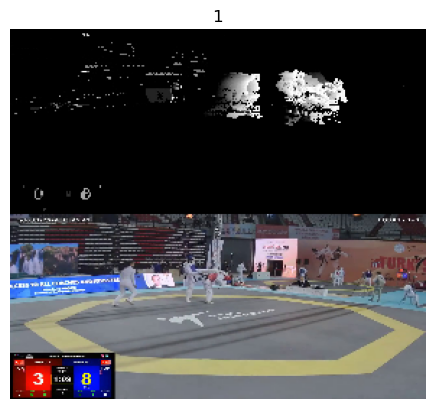

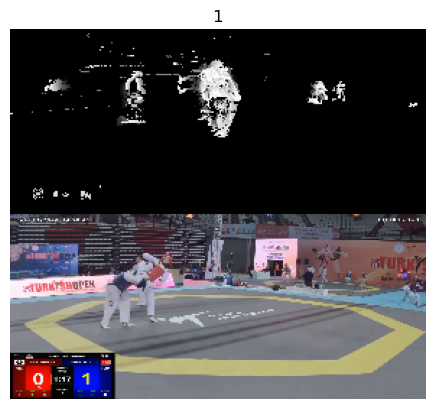

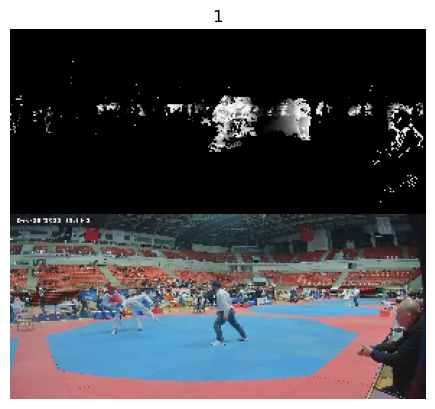

In [84]:
import matplotlib.pyplot as plt

# Tahminleri ve resimleri eşleştirme
for i, prediction in enumerate(predictions):
    if prediction.argmax() == 1:  # Sadece "kafa" sınıfındaki tahminleri göster
        img_path = os.path.join(image_directory, image_filenames[i])
        img = image.load_img(img_path, target_size=(256, 288))
        img_array = image.img_to_array(img)
        
        # Resmi ve tahmin değerini ekrana yazdırma
        plt.imshow(img_array.astype(int))
        plt.title(y_pred_classes[i])
        plt.axis('off')
        plt.show()

## MobilNet2 ile

In [59]:
#y_pred_classes   # mobilNet 2 ile

array([0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0,
       0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1,
       0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0,
       1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0,
       1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0,
       0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0,
       0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0,
       1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0,
       0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1,
       0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1,
       0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0,
       0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0,
       0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0,

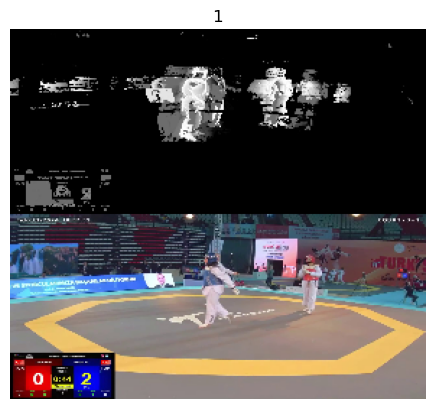

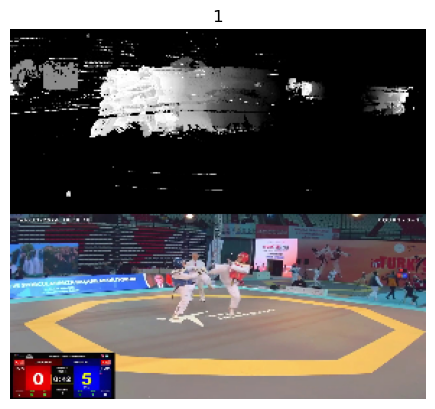

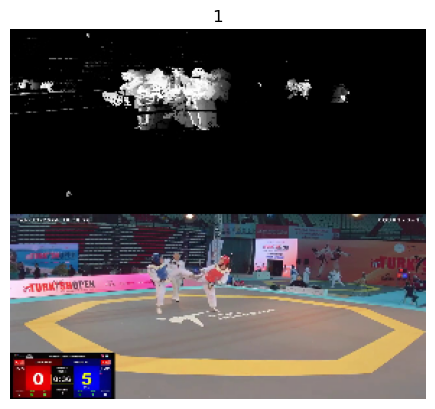

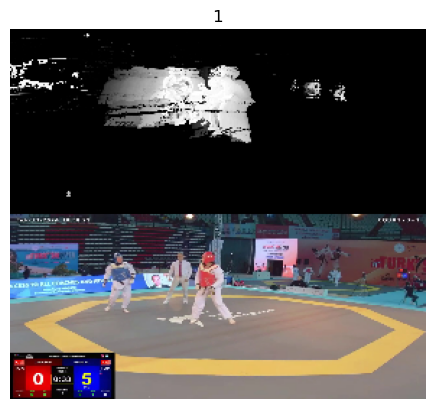

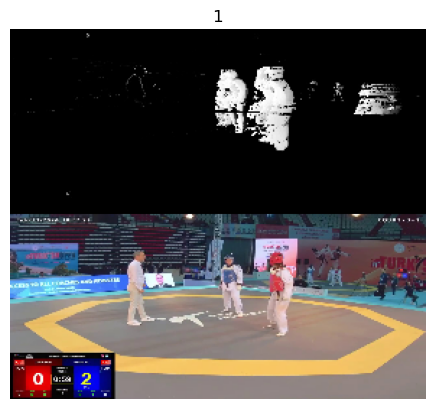

...

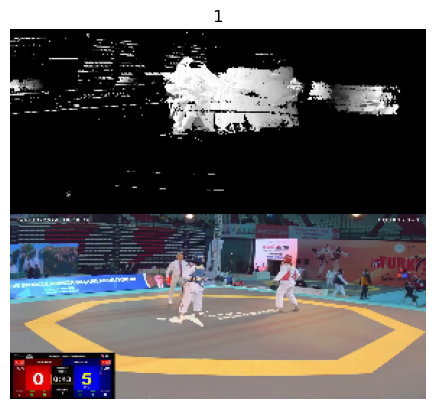

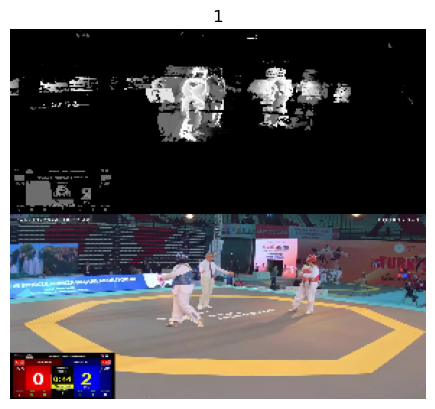

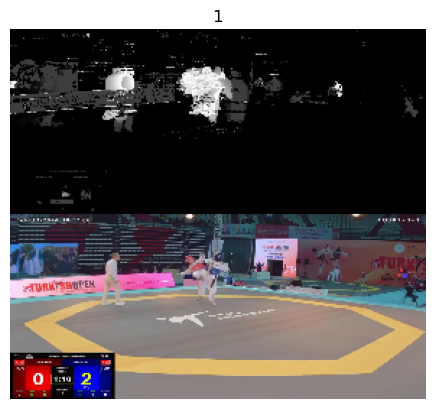

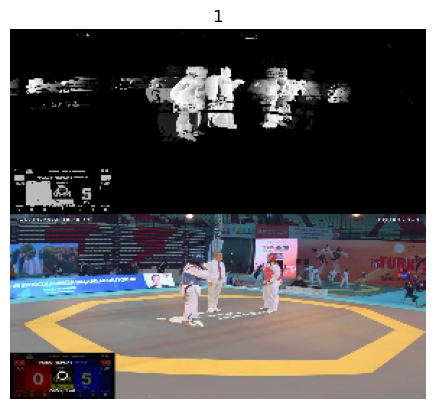

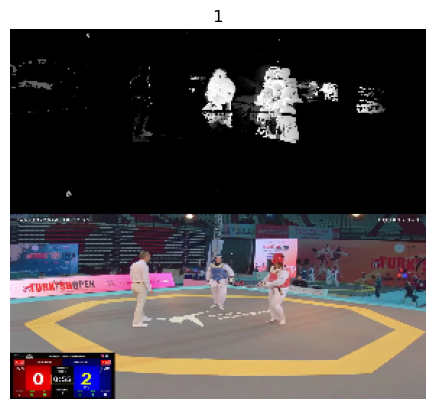

In [60]:
import matplotlib.pyplot as plt

# Tahminleri ve resimleri eşleştirme
for i, prediction in enumerate(predictions):
    if prediction.argmax() == 1:  # Sadece "kafa" sınıfındaki tahminleri göster
        img_path = os.path.join(image_directory, image_filenames[i])
        img = image.load_img(img_path, target_size=(256, 288))
        img_array = image.img_to_array(img)
        
        # Resmi ve tahmin değerini ekrana yazdırma
        plt.imshow(img_array.astype(int))
        plt.title(y_pred_classes[i])
        plt.axis('off')
        plt.show()